<a href="https://colab.research.google.com/github/AIXplorerLize/MLFraud-repo/blob/main/data_audit_report_submission.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dependencies

First we need to install the ydata-profilling library to enable profiling of our data and extract useful insights from it.

In [ ]:
!pip install ydata-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Imports

Next we imported the following packages.

In [ ]:
### Imports
import pandas as pd
import numpy as np

### ydata profiler for EDA
from ydata_profiling import ProfileReport

### Seaborn for visualizations
import matplotlib.pyplot as plt
import seaborn as sns

### Scikit-Learn for imputation and other transformations
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer, PowerTransformer, StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

### Used for feature selection
#### Correlation method - for classification chi2 only
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
#### RFE method - replace the model with the model you plan to use
from sklearn.feature_selection import RFE
#### this method can be used for both topK and cut-off
from sklearn.linear_model import Ridge
#### specifically tree-based feature importance method
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
#### for voting
from collections import Counter
#### for ANOVA
import statsmodels.formula.api as smf
import statsmodels.stats.api as sms

### Used for model evaluation
#### balance the data
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
from sklearn import model_selection
import datetime
from tqdm import tqdm

### Save Data
import pickle

### Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Data Dictionary
_version: v0.1: initial_

| feature name | Type | Definition | Note |
| -------------- | ------ | ------------ | ------ |
| ***TARGET***||COUNT: 1||
| ***fraud_bool*** | binary | __TARGET__, if the application is fraudulent or not | (True, False)/(0,1)|
| ***DEMOGRAPHIC FEATURES***||COUNT: 13|
| **income** | continuous | Standardized annual income of the applicant | [.1, .9] |
| **name_email_similarity** | continuous | similarity between email and applicant's name | [0,1] |
| **prev_address_months_count** | continuous | months in applicant's previous address | [-1, 380], `-1` denotes missing |
| **current_address_months_count** | continuous | months in applicant's current address | [-1, 429], `-1` denotes missing |
| **customer_age** | continuous | Applicants age rounded to decade | [10,90] |
| **zip_count_4w** | continuous | number of applications from the same zip code in past 4 weeks | [1, 6830] |
| **data_of_birth_distinct_emails_4w** | continuous | number of emails of applicants with the same DoB | [0,39] |
| **employment_status** | categorical | employment status of the applicant | 7 possible (anonymized) values |
| **credit_risk_score**| continuous | Internal credit score of applicant's | [-191,389] |
| **email_is_free** | binary | if applicant's email domain is paid | (paid, free) |
| **housing_status** | categorical | current residential status of the applicant | 7 possible (anonymized) values |
| **phone_home_valid** | binary | if applicant's home phone is valid | (True, False)/(0,1)|
| **phone_mobile_valid** | binary | if applicant's mobile phone is valid | (True, False)/(0,1)|
| ***APPLICATION FEATURES***||COUNT: 11||
| **days_since_request** | continuous | days elapsed since the application | [0, 79] |
| **intended_balcon_amount** | continuous | iniitial transfer amount in application (in *thousands* local currency) | [-16, 114] |
| **payment_type** | categorical | Payment plan type | 5 possible (anonymized) values |
| **foreign_request** | binary | if the applicant's country is different from tbe bank's | (True, False)/(0,1)|
| **source** | binary | source/channel of application | {browser: INTERNET, app:TELEAPP} |
| **session_length_in_minutes** | continuous | length of user session (minutes) in website or app | [-1, 107] |
| **device_os** | categorical | type of operating system of the device used for application | (windows, macOS, linux, X11, other) |
| **keep_alive_session** | binary | applicant choose to keep session live or not, after submit application | (True, False)/(0,1)|
| **referred** | categorical | if the application is referred, employee means the applicant is employee of the bank | (referred, not referred, employee) |
| **proposed_credit_limit** | continuous | credit limit in the application, (in *thousands* local currency) | [200, 2000] |
| **month** | continuous | month where the application was make | [0,7] |
| ***CUSTOMER HISTORY FEATURES***||COUNT: 11||
| **velocity_6h** | continuous | average number of applications per hour in the past 6 hours, prior to the current application | [-175, 16818] |
| **velocity_24h** | continuous | average number of applications per hour in the past 24 hours, prior to the current application | [1297,9586] |
| **velocity_4w** | continuous | average number of applications per hour in the past 4 weeks, prior to the current application | [2825,7020] |
| **bank_branch_count_8w** | continuous | total number of applications in the same branch in the past 8 weeks, prior to the current application | [0,2404] |
| **bank_month_count** | continuous | number of months of the pervious account, if exist | [-1, 32], `-1` denotes missing |
| **has_other_cards** | binary | if the applicant has other cards from the same bank | (True, False)/(0,1)|
| **device_distinct_emails** | continuous | number of distinct emails from the same device used in application, in the past 8 weeks | [-1,2] |
| **device_fraud_count** | continuous | number of fraudulent applicants from the same device | [0,1] |
| **under_loan** | binary | if the applicant currently has a loan/mortgage account with the same bank | (True, False)/(0,1)|
| **canceled_other_cards** | binary | if the applicant canceled other account(s) the same bank | (Yes, No)/(0,1)|
| **default_load_or_card** | binary | if the applicant defaulted any loan or card before | (Yes, No)/(0,1)|


We looked at the data dictionary that consists of the feature name, type (continuous or binary), definition and note (possible values range).

# Read Data

Next we read in the data through Google Drive setting the index column to 0.

In [ ]:
### Read in data
data_path = "/content/drive/MyDrive/Classroom/DATA 6545: Data Science and MLOps SP2023/Competition 2/Shared/bank_fraud_train.csv"
raw_data = pd.read_csv(data_path, index_col=0)

In [ ]:
raw_data.head()

,fraud_bool,income,name_email_similarity,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,session_length_in_minutes,device_os,keep_alive_session,device_distinct_emails_8w,device_fraud_count,referred,under_loan,canceled_other_cards,default_loan_or_card,month
0,0,0.2,0.773992,-1,225,10.0,0.002405,-0.476980,AB,1200,...,3.529027,macintosh,0.0,1,0,not referred,0,no,no,4
1,0,0.6,0.298966,-1,41,20.0,0.023593,-1.324930,AC,1650,...,9.124198,other,1.0,1,0,not referred,1,no,no,0
2,1,0.9,0.591834,-1,60,20.0,0.011150,-0.910277,AB,3130,...,11.386064,windows,0.0,1,0,not referred,0,no,no,2
3,0,0.1,0.208465,-1,61,40.0,0.008276,-1.113259,AB,1242,...,5.075136,linux,0.0,1,0,referred,0,no,no,2
4,0,0.7,0.183629,29,13,30.0,5.859822,-1.136572,AA,1499,...,5.951549,other,1.0,1,0,not referred,0,no,no,3


# EDA Before

Next, we used ProfileReport to generate a comprehensive report of the 'raw_data' dataframe's characteristics and statistics. This report provides us with a detailed overview of the data's distribution, correlations, and missing values.

In [ ]:
profile = ProfileReport(raw_data)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Based on the insights we got from the ProfileReport overview, we made some validation corrections.
Validations that we made were:
- Fixing the 'velocity_6h' column by converting negative values to -1 as 'missing' values
- Converting the 'source' column to binary by setting values of 'INTERNET' to 1 and everything else to 0
- Converting the 'customer_age' column to binary by setting values less than 50 to 1, values greater than or equal to 50 to 0, and NaN values to -1
- Converting the 'employment_status' column to binary by setting values of 'CA' to 1, NaN values to -1, and everything else to 0
- Converting the 'housing_status' column values to 'BA', 'BB', 'BC', 'BE', or 'Other'
- Replacing all instances of -1 in the columns 'prev_address_months_count', 'current_address_months_count', 'bank_months_count', 'session_length_in_minutes', 'device_distinct_emails_8w', 'customer_age', 'employment_status', and 'housing_status' with NaN
- Dropping the columns 'month', 'device_fraud_count', and 'prev_address_months_count'

In [ ]:
df = raw_data.copy()

### Validation Corrections
### Check credit_risk_score and intended_balcon_amount to see if -1 appears
df["velocity_6h"] = np.where(df["velocity_6h"] < 0, -1, df["velocity_6h"])
df["source"] = np.where(df["source"] == "INTERNET", 1, 0)
df["customer_age"] = np.where(df["customer_age"] < 50, 1, np.where(df["customer_age"] >= 50, 0, -1))

### check model performance on this
df["employment_status"] = np.where(df["employment_status"] == "CA", 1, np.where(df["employment_status"].isna(), -1, 0))

df["housing_status"] = df["housing_status"].apply(lambda x: x if x in ["BA", "BB", "BC", "BE"] else (-1 if str(x) != "nan" else "Other"))

cols = ["prev_address_months_count", "current_address_months_count",
        "bank_months_count", "session_length_in_minutes",
        "device_distinct_emails_8w", "customer_age",
        "employment_status", "housing_status", "velocity_6h"]
df[cols] = df[cols].replace(-1, np.nan)

#### revisit month (binned) - not enough to exclude
#### prev_address_months_count - turn into binary
#### current address - don't care about how long. binary based on threshold
#### explore vairance of 3 velocieites. One with most would be most valuable. ANOVA across all 3 and target
#### binary for bank_branck_count_8w 0 is 0 and other is 1
df.drop(["month", "device_fraud_count", "prev_address_months_count", "velocity_24h"], axis=1, inplace=True)

#### income is pre-binned - might want to explore (value count)

Next, we separated the columns between continuous and categorical features by creating lists for each in the 'df' dataframe.

In [ ]:
### Separate continuous and categorical columns
### slice dataframe based on categorical columns
cat_cols = list(df.select_dtypes(include="object").columns)
cat_cols.extend(["phone_home_valid", "customer_age",
                 "phone_mobile_valid", "foreign_request",
                 "source", "keep_alive_session", "under_loan",
                 "email_is_free", "has_other_cards","employment_status"])
df.loc[:, cat_cols] = df.loc[:, cat_cols].astype("category")
# #### iterate through df columns and add any column that is not in categorical list
cont_cols = [col for col in df.columns if col not in cat_cols]
cont_cols = cont_cols[1:]

df = pd.concat([df[cont_cols], df[cat_cols], df["fraud_bool"]], axis=1)

We looked at the data types to see if the data validation and lists got separated correctly.

In [ ]:
df.dtypes

income                               float64
name_email_similarity                float64
current_address_months_count         float64
days_since_request                   float64
intended_balcon_amount               float64
zip_count_4w                           int64
velocity_6h                          float64
velocity_4w                          float64
bank_branch_count_8w                   int64
date_of_birth_distinct_emails_4w       int64
credit_risk_score                      int64
bank_months_count                    float64
proposed_credit_limit                float64
session_length_in_minutes            float64
device_distinct_emails_8w            float64
payment_type                        category
housing_status                      category
device_os                           category
referred                            category
canceled_other_cards                category
default_loan_or_card                category
phone_home_valid                    category
customer_a

# Transformations

We started with the transformations. First was the IQR outlier handling and then the 6 sigma outlier handling. We also created 6 pipelines for each process.

In [ ]:
### Handle outliers by IQR
def out_IQR(col):
    iqr = 1.5 * (np.quantile(col, 0.75) - np.quantile(col, 0.25))
    up_bound = np.quantile(col,.75) + iqr
    low_bound = np.quantile(col,.25) - iqr
    col[col > up_bound], col[col < low_bound] = up_bound, low_bound
    return col

outlier_handler_IQR = FunctionTransformer(out_IQR)

In [ ]:
### Handle outliers by 6 sigma
def out_6sigma(col):
    up_bound = np.mean(col) + 3 * np.std(col)
    low_bound = np.mean(col) - 3 * np.std(col)
    col[col > up_bound], col[col < low_bound] = up_bound, low_bound
    return col

outlier_handler_6sigma = FunctionTransformer(out_6sigma)

In [ ]:
cont_1A = Pipeline([
    ("cont_imputer", SimpleImputer(strategy="most_frequent")), ### imputer
    ("skewness", PowerTransformer()), ### skewness removal
    ("outlier", outlier_handler_6sigma), ### outlier handling
    ("scaler", StandardScaler()), ### z-score scaler
])

In [ ]:
cont_1B = Pipeline([
    ("cont_imputer", SimpleImputer(strategy="most_frequent")), ### imputer
    ("skewness", PowerTransformer()), #### skewness removal
    ("scaler", StandardScaler()), ### z-score scaler
    ("outlier", outlier_handler_6sigma), ### outlier handling
])

In [ ]:
cont_2A = Pipeline([
    ("cont_imputer", SimpleImputer(strategy="most_frequent")), ### imputer
    ("outlier", outlier_handler_IQR), ### outlier handling
    ("scaler", MinMaxScaler()), ### min-max scaler
    ("skewness", PowerTransformer()), ### skewness removal
])

In [ ]:
cont_2B = Pipeline([
    ("cont_imputer", SimpleImputer(strategy="most_frequent")), ### imputer
    ("scaler", MinMaxScaler()), ### min-max scaler
    ("outlier", outlier_handler_IQR), ### outlier handling
    ("skewness", PowerTransformer()), ### skewness removal
])

In [ ]:
cont_3A = Pipeline([
    ("cont_imputer", SimpleImputer(strategy="most_frequent")), ### imputer
    ("scaler", MinMaxScaler()), ### min-max scaler
    ("skewness", PowerTransformer()), ### skewness removal
    ("outlier", outlier_handler_6sigma), ### outlier handling
])

In [ ]:
cont_3B = Pipeline([
    ("cont_imputer", SimpleImputer(strategy="most_frequent")), ### imputer
    ("outlier", outlier_handler_IQR), ### outlier handling
    ("skewness", PowerTransformer()), ### skewness removal
    ("scaler", StandardScaler()), ### z-score scaler
])

We created a list of pipelines for preprocessing continuous variables and apply them to the DataFrame 'df'. We applied a preprocessing pipeline to the categorical variables using SimpleImputer and OneHotEncoder, and store the processed DataFrames in a list called 'processed_dfs'.
The continuous variable pipelines are defined in the list 'pipelines'. We used the ColumnTransformer class to apply each pipeline to the continuous variables in 'df'. The transformed data was then combined with the preprocessed categorical variables to create a new DataFrame with the desired features.
Finally, we appended the transformed DataFrames to the list 'processed_dfs'.

In [ ]:
pipelines = [cont_1A, cont_1B, cont_2A, cont_2B, cont_3A, cont_3B]
processed_dfs = []

cat = Pipeline([
    ("cat_imputer", SimpleImputer(strategy="most_frequent")),
    ("onehot", OneHotEncoder(categories='auto', handle_unknown='ignore', drop='if_binary')),
])

for pipe in pipelines:
    ct = ColumnTransformer([
    # (name, transformer, columns)
    # Transformer for continuous variables
    ("cont_preproc", pipe, cont_cols),
    # Transformer for categorical variables
    ("cat_preproc", cat, cat_cols)],
    # what to do with variables not specified in the indices?
    remainder="drop")

    df_pipe = df.copy()
    df_pipe_transformed = ct.fit_transform(df_pipe)
    ohe_cat_cols = list(ct.named_transformers_["cat_preproc"].named_steps['onehot'].get_feature_names_out(cat_cols))
    cols = cont_cols + ohe_cat_cols
    Xpipe_train_transformed = pd.DataFrame(df_pipe_transformed, columns=cols)

    processed_dfs.append(Xpipe_train_transformed)

assert len(processed_dfs) == 6
#### check shape is the same for all of them

/usr/local/lib/python3.9/dist-packages/numpy/core/_methods.py:235: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/usr/local/lib/python3.9/dist-packages/numpy/core/_methods.py:246: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(x, axis, dtype, out, keepdims=keepdims, where=where)
/usr/local/lib/python3.9/dist-packages/numpy/core/_methods.py:235: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/usr/local/lib/python3.9/dist-packages/numpy/core/_methods.py:246: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(x, axis, dtype, out, keepdims=keepdims, where=where)


In [ ]:
### Change based on where you want the files saved
path = "/content/drive/MyDrive/Classroom/DATA 6545: Data Science and MLOps SP2023/Competition 2/Shared/carlos/"

In [ ]:
with open(path + 'processed_dfs.obj', 'wb') as f:
    pickle.dump(processed_dfs, f)

In [ ]:
filename = path + 'processed_dfs.obj'
with open(filename, 'rb') as f:
    processed_dfs = pickle.load(f)

In [ ]:
#### Do EDA to see if pipelines worked
#### show assumptions fulfilled (no missing, no skewness, no outliers) in 2 x 3 collection of barcharts and boxplots

# Feature Selection

We implemented a function called feature_selector which performed a voting-based feature selection. The function took in arguments X, y, model, names, _method, n, fit_X, and thres. The function selected a certain number of features either through the top-K method or cut-off based method depending on the value of _method. The function used several methods to select features including SelectKBest, RFE, Ridge, ExtraTreesClassifier, and RandomForestClassifier.

The function then combined the results using voting and selected the most important features based on the votes. The final selected features were stored in final_select_series. The function returned either the transformed X with the selected features or the names of the selected features based on the value of fit_X.

The function was tested for various use cases and assertions were added to ensure the correct number of features were selected.

In [ ]:
### features, targets, model

def feature_selector(X, y, model, names, _method="topk", n=0, fit_X=False, thres = 0.1):
  """voting based feature selector
  - _method: "topk" for top-K method (default), "cutoff" for cut-off based method
  - n: number of features to be selected. only available for top-K method - default half of the total features
  - thres: cut-off threshold (default 0.1), only availabel for cutoff method
  - fit_X: fit_transform X or just return indices
  TODO: include support for regression problems
  """
  #### Placeholder for tests
  # X.shape[0] == y.shape[0]
  if n == 0:
    n = int(X.shape[1]/2)
  if names: # if given feature names
    feature_names = np.array(names)
  else: # otherwise use location
    feature_names = np.array(["X%s" % x for x in range(len(X.shape[0]))])
  if _method == 'topk':
    #### np.argpartition gets the indices of the largest n element from the array in ascending order
    #### [::-1] reverse the order
    ############################################################################
    #### IMPORTANT:
    #### use `chi2` as the `score_func` when doing categorical features - values has to be non-negative
    #### use `f_classif` as the `score_func` when doing categorical and continuous feautures
    #### use `f_regression` as the `score_func` when doing continuous feautures
    ############################################################################
    corr_features = list(np.argpartition(SelectKBest().fit(X,y).scores_, -n)[-n:][::-1])
    #### binary masking on features, use np.where() to get the indices of selected
    rfe_features = list(np.where(RFE(model, n_features_to_select=n, step=1).fit(X, y).support_)[0])
    #### argsort get sorted indices by values, ::-1] reverse the asceding order
    ridge_features = list(np.argsort(Ridge(alpha=1.0).fit(X, y).coef_)[-n:][::-1])
    #### using ExtraTree
    extratree_features = list(np.argsort(ExtraTreesClassifier().fit(X, y).feature_importances_)[-n:][::-1])
    ### using Random Forest:
    rf_features = list(np.argsort(RandomForestClassifier().fit(X, y).feature_importances_)[-n:][::-1])
    # print("Using the Top-K method: ")
    # print("Selected features by correlation: ", feature_names[corr_features])
    # print("Selected features by RFE: ", feature_names[rfe_features])
    # print("Selected features by Ridge coefficients: ", feature_names[ridge_features])
    # print("Selected features by Extra Tree feature importance: ", feature_names[extratree_features])
    # print("Selected features by Random Forest feature importance: ", feature_names[rf_features])

  elif _method == 'cutoff':
    corr_features, rfe_features = list(), list() #### N/A
    ridge_features = list(np.where(Ridge(alpha=1.0).fit(X, y).coef_ > thres)[0])
    extratree_features = list(np.where(ExtraTreesClassifier().fit(X, y).feature_importances_ > thres)[0])
    rf_features = list(np.where(RandomForestClassifier().fit(X, y).feature_importances_ > thres)[0])
    print("Using the Cutoff method: ")
    # print("Selected features by correlation: ", feature_names[corr_features])
    # print("Selected features by RFE: ", feature_names[rfe_features])
    print("Selected features by Ridge coefficients: ", feature_names[ridge_features])
    print("Selected features by Extra Tree feature importance: ", feature_names[extratree_features])
    print("Selected features by Random Forest feature importance: ", feature_names[rf_features])
  else:
    return("Only Top-K and Cutoff methods are currently supported!")

  ######################################
  #### combine results using voting ####
  ######################################
  counted = Counter(np.concatenate((corr_features, rfe_features, ridge_features, extratree_features, rf_features), axis=None)).most_common(n)

  #### list of tuples (feature_index, votes)
  counted.sort(key = lambda x: x[1], reverse=True)
  final_select_series = pd.Series({feature_names[f]:c for f,c in counted}).sort_values(ascending=False)
  selected_idx = sorted([f for f,c in counted])
  assert len(selected_idx) == n
#   print(final_select_series)
  if fit_X:
    return(X[:, selected_idx])
  else:
    return(feature_names[selected_idx])

The selected_features list was populated with the features selected by feature_selector() function using a RandomForestClassifier() model. The function was called for each processed dataframe with the corresponding target variable y and feature names names.

In [ ]:
selected_features = []

names = list(processed_dfs[0].columns)
y = df["fraud_bool"].values

for i in range(len(processed_dfs)):
    X = processed_dfs[i].values
    print("Process: {}".format(i))
    features = list(feature_selector(X, y, model=RandomForestClassifier(), names=names))
    selected_features.append(features)

Process: 0
Process: 1
Process: 2


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: UserWarning: Features [7] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw


Process: 3
Process: 4
Process: 5


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: UserWarning: Features [7] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw


In [ ]:
#### transformation is causing /0

print(processed_dfs[2].iloc[:, 8].name)
print(processed_dfs[2].iloc[:, 9].name)
print(processed_dfs[2].iloc[:, 19].name)

bank_branch_count_8w
date_of_birth_distinct_emails_4w
payment_type_AE


We created a dictionary to store the selected features for each processed dataframe, then converted it into a pandas dataframe called features_df.

In [ ]:
#### check CA employment compared to income to see what it might be
#### cross check housing with current address to provide more detail

### Questions
#### Look for something that doesn't make sense - side analytical/feature questions
#### Things that need more clarification. Features that have zero variance

In [ ]:
features_dict = {}

for i, v in enumerate(selected_features):
    features_dict[i] = v

features_df = pd.DataFrame(features_dict)
features_df

,0,1,2,3,4,5
0,income,income,income,income,income,income
1,name_email_similarity,name_email_similarity,name_email_similarity,name_email_similarity,name_email_similarity,name_email_similarity
2,current_address_months_count,current_address_months_count,current_address_months_count,current_address_months_count,current_address_months_count,current_address_months_count
3,days_since_request,days_since_request,days_since_request,days_since_request,days_since_request,days_since_request
4,intended_balcon_amount,intended_balcon_amount,intended_balcon_amount,intended_balcon_amount,intended_balcon_amount,intended_balcon_amount
5,zip_count_4w,zip_count_4w,zip_count_4w,zip_count_4w,zip_count_4w,zip_count_4w
6,velocity_6h,velocity_6h,bank_branch_count_8w,velocity_6h,velocity_6h,bank_branch_count_8w
7,velocity_4w,velocity_4w,date_of_birth_distinct_emails_4w,velocity_4w,velocity_4w,date_of_birth_distinct_emails_4w
8,bank_branch_count_8w,bank_branch_count_8w,credit_risk_score,bank_branch_count_8w,bank_branch_count_8w,credit_risk_score
9,date_of_birth_distinct_emails_4w,date_of_birth_distinct_emails_4w,bank_months_count,date_of_birth_distinct_emails_4w,date_of_birth_distinct_emails_4w,bank_months_count


We created new dataframes by selecting only the columns with the selected features for each processed dataframe.

In [ ]:
new_dfs = []
for i, v in enumerate(selected_features):
    feats = selected_features[i]
    new_dfs.append(processed_dfs[i][feats])

#### can use bootstrapping to check these features

We saved the new dataframes new_dfs as a binary file in the specified directory using pickle module and also added code to reload it so we could manipulate the dataframes without fitting and transforming them every time.

In [ ]:
with open(path + 'new_dfs.obj', 'wb') as f:
    pickle.dump(new_dfs, f)

In [ ]:
filename = path + 'new_dfs.obj'
with open(filename, 'rb') as f:
    new_dfs = pickle.load(f)

# EDA After

We performed EDA by computing descriptive statistics for the fourth DataFrame in new_dfs.

In [ ]:
selected_df = new_dfs[2]
selected_df_cont = selected_df.iloc[:, :13]

In [ ]:
selected_df.describe().T

,count,mean,std,min,25%,50%,75%,max
income,100000.0,-4.110490e-16,1.000005,-1.498620,-0.953139,0.041070,0.816367,1.236746
name_email_similarity,100000.0,1.267253e-16,1.000005,-1.801218,-0.920252,0.038625,0.910599,1.674801
current_address_months_count,100000.0,2.490808e-16,1.000005,-1.482857,-0.913062,-0.162675,0.884081,1.949347
days_since_request,100000.0,-6.608047e-18,1.000005,-0.374668,-0.345861,-0.314035,-0.270382,3.465151
intended_balcon_amount,100000.0,-1.160778e-15,1.000005,-9.298548,-0.609157,-0.522936,0.554999,1.930811
zip_count_4w,100000.0,9.491075e-17,1.000005,-3.826298,0.270563,0.270563,0.270563,0.270563
bank_branch_count_8w,100000.0,-2.742695e-17,1.000005,-0.763499,-0.721700,-0.410831,0.130548,2.106495
date_of_birth_distinct_emails_4w,100000.0,3.091571e-16,1.000005,-2.493907,-0.654641,0.036145,0.792335,3.251818
credit_risk_score,100000.0,-1.735430e-15,1.000005,-5.406181,-0.671978,-0.069424,0.706069,3.200444
bank_months_count,100000.0,-4.320100e-17,1.000005,-0.971030,-0.971030,-0.337045,1.189854,1.441674


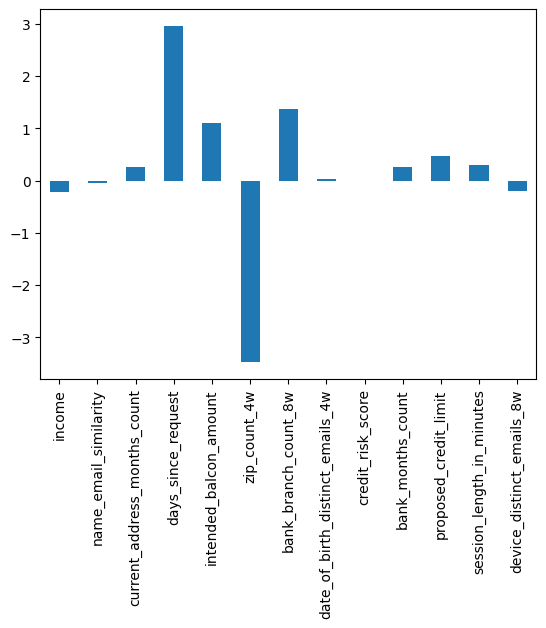

In [ ]:
selected_df_cont.skew().plot(kind="bar");

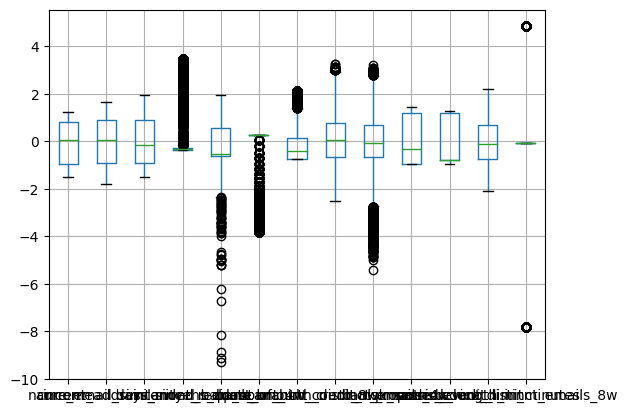

In [ ]:
selected_df_cont.boxplot();

# Evaluation

Next, we defined a dictionary with one model, logistic regression, and set several parameters for the evaluation of the model, including the number of folds, random state, metrics, and rounds. We then defined a function, model_eval, that applies SMOTE to the training data and evaluates the model using cross-validation. The function returns the scores of the evaluation metrics. Finally, we applied model_eval to each of the processed datasets and saved the results in a CSV file named results.csv.

In [ ]:
models = {
  "lr": LogisticRegression(max_iter=2000),
}

In [ ]:
## Number of folds in k-fold
k = 10
RANDOM_STATE = int(datetime.date.today().year)
METRICS = ['f1', 'roc_auc'] ### also, AUC is not supported for multi-class problems
ROUNDS = 3 ## evaluation rounds

In [ ]:
def model_eval(X_train_transformed, y_train, models, metrics=METRICS, k=k, rounds=ROUNDS):
    """evaluating multiple models"""
    sm = SMOTE(random_state = RANDOM_STATE)
    X_res, y_res = sm.fit_resample(X_train_transformed, y_train)
    for model_name, classifier in models.items():
      print("training {} ...".format(classifier))
      scores = []
      for i in tqdm(range(rounds)):
        np.random.seed(RANDOM_STATE)
        random_int = np.random.randint(0,3000)
        kfold = model_selection.KFold(n_splits=k, random_state=random_int, shuffle=True)
        scores.append(model_selection.cross_val_score(classifier, X=X_res, y=y_res, cv=kfold, scoring=metrics))
      res = np.array(scores).flatten()
    return res

In [ ]:
y_eval = df["fraud_bool"].values
results = {}

for d in range(len(new_dfs)):
    X_eval = new_dfs[d].values
    results[d] = model_eval(X_eval, y_eval, models, metrics = "f1_macro")

training LogisticRegression(max_iter=2000) ...


100%|██████████| 3/3 [00:31<00:00, 10.47s/it]


training LogisticRegression(max_iter=2000) ...


100%|██████████| 3/3 [00:29<00:00,  9.81s/it]


training LogisticRegression(max_iter=2000) ...


100%|██████████| 3/3 [00:31<00:00, 10.50s/it]


training LogisticRegression(max_iter=2000) ...


100%|██████████| 3/3 [00:27<00:00,  9.01s/it]


training LogisticRegression(max_iter=2000) ...


100%|██████████| 3/3 [00:27<00:00,  9.30s/it]


training LogisticRegression(max_iter=2000) ...


100%|██████████| 3/3 [00:31<00:00, 10.57s/it]


In [ ]:
results_df = pd.DataFrame(results)
results_df.to_csv("/content/drive/MyDrive/Classroom/DATA 6545: Data Science and MLOps SP2023/Competition 2/Shared/carlos/results.csv")
results_df

,0,1,2,3,4,5
0,0.803740,0.804094,0.803994,0.804297,0.803994,0.803134
1,0.802425,0.802172,0.800955,0.801615,0.803028,0.800503
2,0.804981,0.803764,0.802254,0.802394,0.802343,0.802246
3,0.808441,0.808341,0.802626,0.806620,0.809042,0.805255
4,0.808048,0.808050,0.802030,0.806851,0.807152,0.805376
5,0.801996,0.800732,0.800580,0.802397,0.802804,0.801489
6,0.803929,0.803829,0.800895,0.801291,0.802256,0.801906
7,0.803559,0.804015,0.802143,0.800671,0.801636,0.804222
8,0.802465,0.802313,0.801353,0.802717,0.802970,0.802364
9,0.805572,0.805014,0.802739,0.804862,0.806179,0.805839


In [ ]:
results_df.mean()
#### highest value

0    0.804516
1    0.804233
2    0.801957
3    0.803372
4    0.804141
5    0.803233
dtype: float64

In [ ]:
#### F1 and AUC higher
#### bias and variance lower

We evaluated multiple models using cross-validation and SMOTE to handle class imbalance. The results were saved to a CSV file. Based on the F1 macro score, the top performing process is 2A. We plan to do further analysis on the top 2 or 3 processes before making a final decision.